# Datavisualization

### Index:

- 2D Plot:
1. Scatter Plot
2. Line Plot
3. Histogram Plot
4. Bar Plot
5. Pie Chart Plot
6. Box Plot
7. Heat Map
8. Faceting
9. Pairplot
10. Time Plot
11. Tree Plot
12. Sunburst Plot
13. Bubble Plot
14. Calender Plot
15. Violin Plot
16. Folium Map Plot
17. Choropleth
18. Rose Plot

- 3D plot:
1. Surface Plot
2. Scatter Plot
3. Bar Plot
4. Volume Plot

### Datasets used:
- factors-affecting-campus-placement (cp)
- house-prices-advanced-regression-techniques (df1)
- titanic (age)
- competitive-data-science-predict-future-sales (sales)
- wine-reviews (win_reviews)
- novel-corona-virus-2019 (corona_data)
- covid19-in-india (covid_India_cases)
- global-hospital-beds-capacity-for-covid19 (m)
- iris-flower-dataset (iris)

## Guide

In [1]:
guide_used = "https://www.kaggle.com/code/soham1024/introduction-2d-3d-data-visualization#Why-do-we-need-data-visualization?"

## Make necessary imports

In [84]:
import opendatasets as od
import numpy as np
import pandas as pd
from pandas.plotting import scatter_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from plotly.offline import iplot, init_notebook_mode
import plotly.offline as pyo
import plotly.graph_objs as go
import plotly.express as px
# from bubbly.bubbly import bubbleplot 
from plotly.offline import iplot
import chart_studio.plotly as py
import calmap
import folium
# from chord import Chord
from mpl_toolkits import mplot3d
from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA
import random

import warnings
warnings.filterwarnings("ignore")

## Importing data
Read data:

In [3]:
dataset_url = "https://www.kaggle.com/datasets/benroshan/factors-affecting-campus-placement/data"
cp = pd.read_csv("./extra-datasets/Placement_Data_Full_Class.csv")

In [4]:
dataset_url = "https://www.kaggle.com/competitions/house-prices-advanced-regression-techniques/data"
df1 = pd.read_csv("./extra-datasets/train_housing.csv")

In [5]:
dataset_url = "https://www.kaggle.com/c/titanic/data"
age = pd.read_csv("./extra-datasets/train_titanic.csv")

In [6]:
dataset_url = "https://www.kaggle.com/datasets/atmadja/predict-future-sales"
sales = pd.read_csv("./extra-datasets/items_future_sales.csv")

In [7]:
dataset_url = "https://www.kaggle.com/datasets/christopheiv/winemagdata130k"
wine_reviews = pd.read_csv("./extra-datasets/winemag-data-130k-v2.csv", index_col=0)

In [21]:
dataset_url = "https://www.kaggle.com/datasets/sudalairajkumar/novel-corona-virus-2019-dataset"
corona_data = pd.read_csv('./extra-datasets/covid_19_data.csv')

In [22]:
dataset_url = "https://www.kaggle.com/datasets/sudalairajkumar/covid19-in-india"
covid_India_cases = pd.read_csv('./extra-datasets/covid_19_india.csv')

In [29]:
dataset_url = "https://www.kaggle.com/datasets/ikiulian/global-hospital-beds-capacity-for-covid19"
m = pd.read_csv("./extra-datasets/hospital_beds_USA_v1.csv")

In [8]:
od.download("https://www.kaggle.com/datasets/arshid/iris-flower-dataset")   # Got error, so I downloaded it manually
file = 'iris-flower-dataset/IRIS.csv'
iris = pd.read_csv(file)

Skipping, found downloaded files in ".\iris-flower-dataset" (use force=True to force download)


## 2D-Plots

1. Scatter plot

<Axes: xlabel='sepal_length', ylabel='sepal_width'>

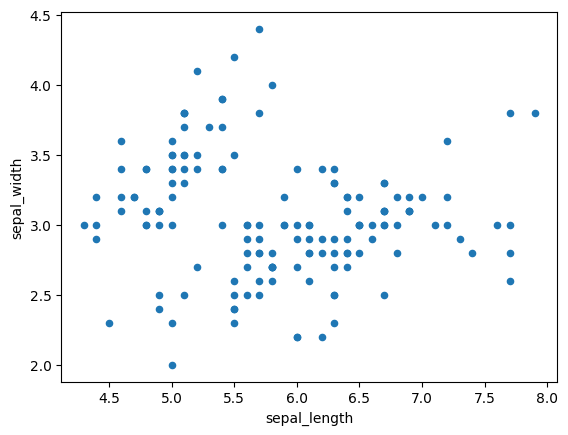

In [29]:
iris.plot(kind="scatter", x="sepal_length", y="sepal_width")

2. Line plot

<Axes: title={'center': 'Iris Dataset'}>

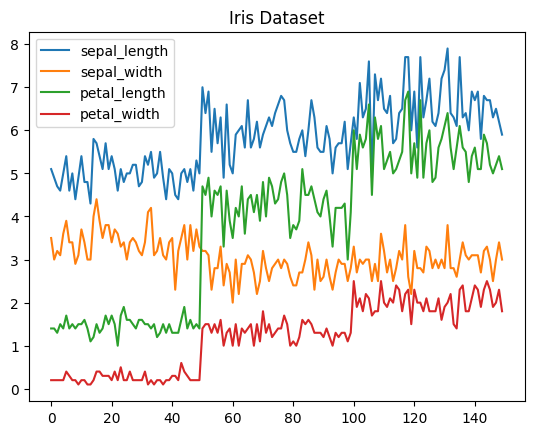

In [28]:
iris.drop(['species'], axis=1).plot.line(title='Iris Dataset')

<Axes: >

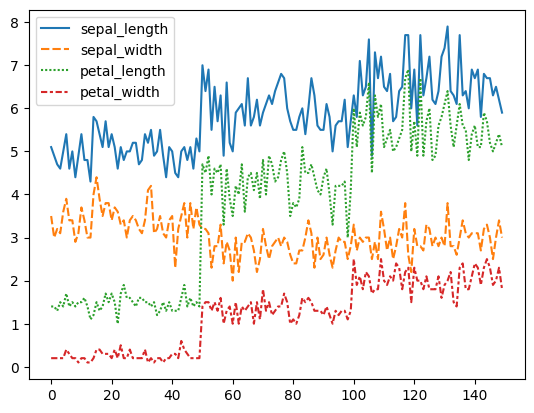

In [30]:
sns.lineplot(data=iris.drop(['species'], axis=1))

3. Histogram plot

Text(0, 0.5, 'Frequency')

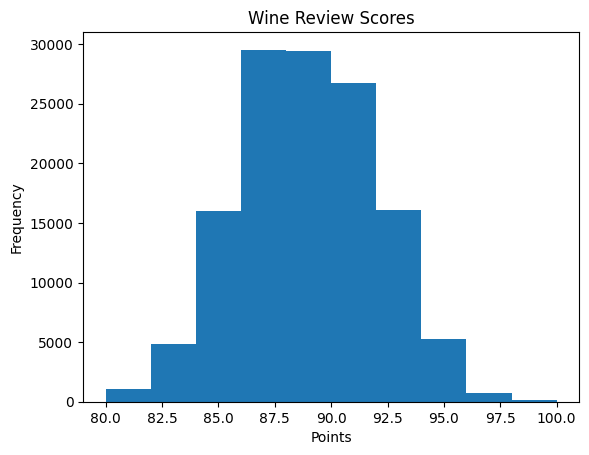

In [44]:
# create figure and axis
fig, ax = plt.subplots()
# plot histogram
ax.hist(wine_reviews['points'])
# set title and labels
ax.set_title('Wine Review Scores')
ax.set_xlabel('Points')
ax.set_ylabel('Frequency')

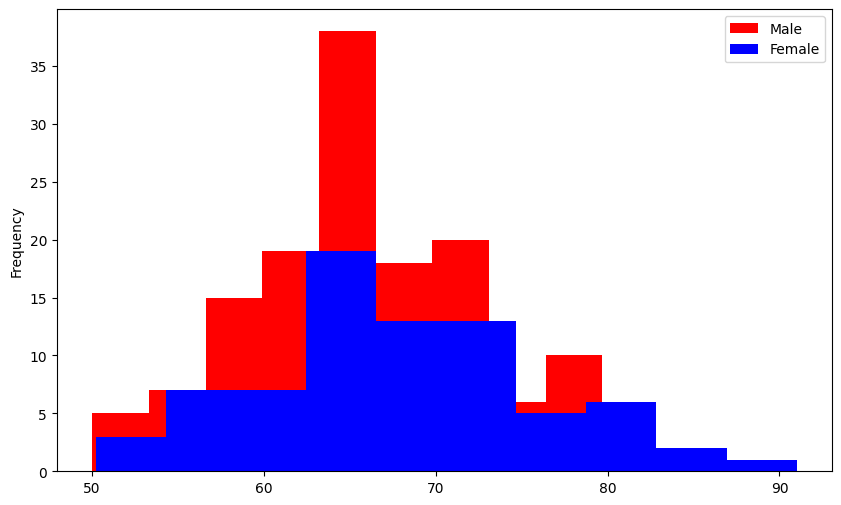

In [45]:
m = cp[cp['gender']=="M"]
f = cp[cp['gender']=="F"]
plt.figure(figsize=(10,6))
ax = m['degree_p'].plot.hist(bins=10 ,color="red")
ax = f['degree_p'].plot.hist(bins=10,color="blue")
plt.legend(['Male', 'Female'])

array([[<Axes: ylabel='Frequency'>, <Axes: ylabel='Frequency'>],
       [<Axes: ylabel='Frequency'>, <Axes: ylabel='Frequency'>]],
      dtype=object)

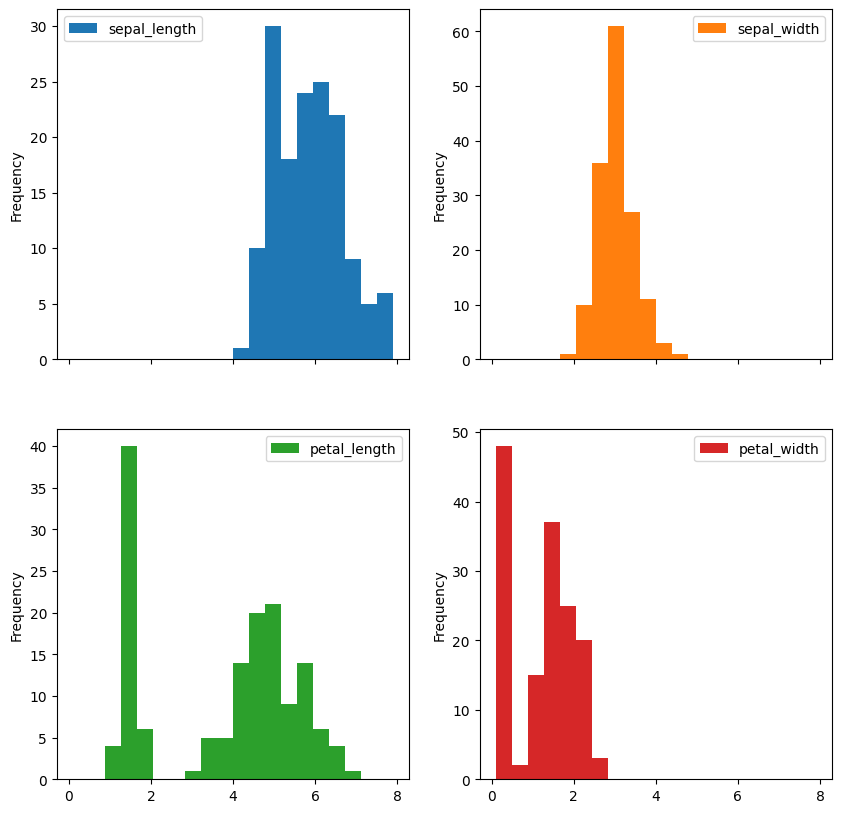

In [47]:
iris.plot.hist(subplots=True, layout=(2,2), figsize=(10, 10), bins=20)

<Axes: xlabel='points'>

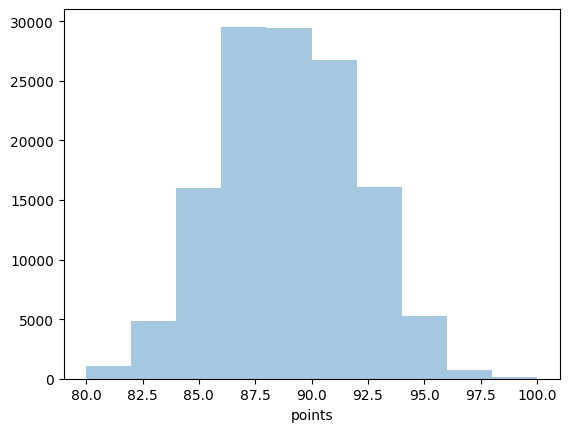

In [48]:
sns.distplot(wine_reviews['points'], bins=10, kde=False)

<Axes: xlabel='points', ylabel='Density'>

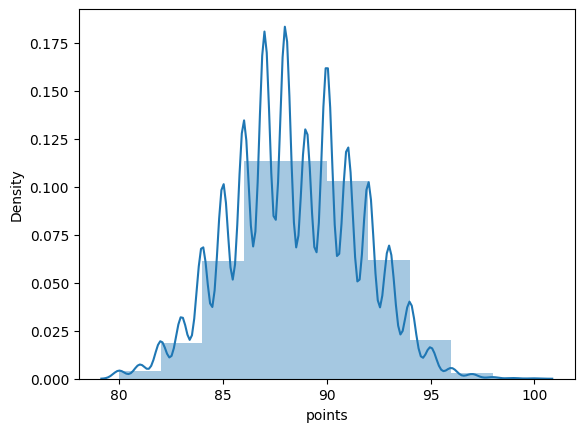

In [49]:
sns.distplot(wine_reviews['points'], bins=10, kde=True)

4. Bar plot

Text(0, 0.5, 'Frequency')

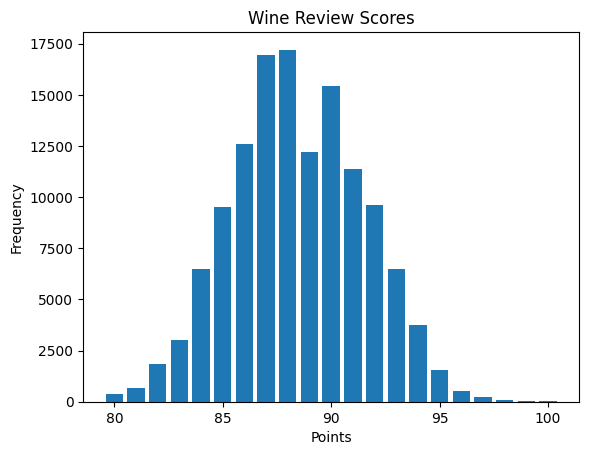

In [50]:
# create a figure and axis 
fig, ax = plt.subplots() 

# count the occurrence of each class 
data = wine_reviews['points'].value_counts() 

# get x and y data 
points = data.index 
frequency = data.values 

# create bar chart 
ax.bar(points, frequency) 

# set title and labels 
ax.set_title('Wine Review Scores') 
ax.set_xlabel('Points') 
ax.set_ylabel('Frequency')

<Axes: xlabel='points'>

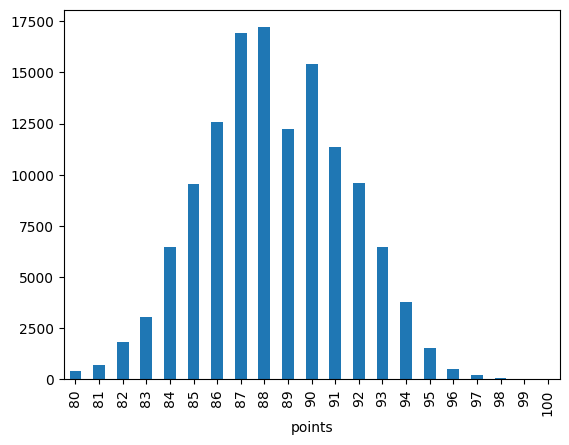

In [51]:
wine_reviews['points'].value_counts().sort_index().plot.bar()

<Axes: ylabel='points'>

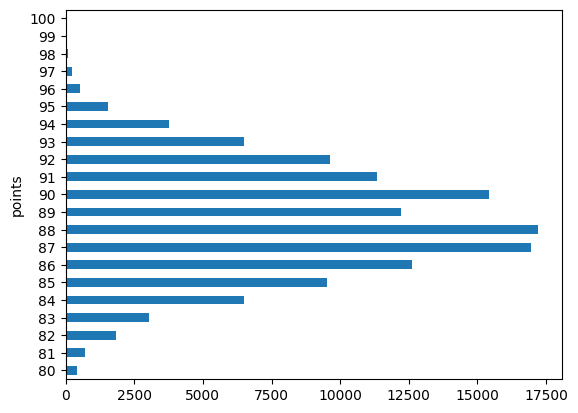

In [52]:
wine_reviews['points'].value_counts().sort_index().plot.barh()

<Axes: xlabel='country'>

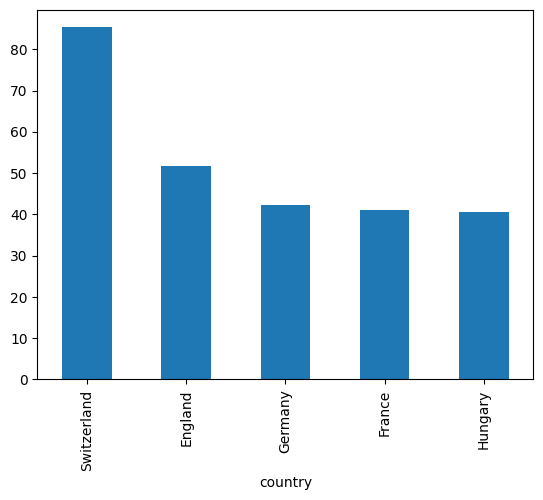

In [53]:
wine_reviews.groupby("country").price.mean().sort_values(ascending=False)[:5].plot.bar()

In [1]:
# THIS DOES NOT WORK (Runs indefinetly)
# sns.countplot(wine_reviews['points'])

In [69]:
grgs = cp.groupby(["gender","specialisation"])[["salary"]].mean().reset_index()
fig = px.bar(grgs[['gender', 'salary','specialisation']].sort_values('salary', ascending=False), 
             y="salary", x="gender", color='specialisation', 
             log_y=True, template='ggplot2')
fig.show()

5. Pie chart

In [67]:
grdsp = cp.groupby(["degree_t"])[["degree_p"]].mean().reset_index()

fig = px.pie(grdsp,
             values="degree_p",
             names="degree_t",
             template="seaborn")
fig.update_traces(rotation=45, pull=0.03, textinfo="percent+label")
fig.show()

6. Box plot

In [82]:
# THIS DOES NOT WORK
df = wine_reviews[(wine_reviews['points']>=95) & (wine_reviews['price']<1000)]
sns.boxplot('points', 'price', data=df)

TypeError: boxplot() got multiple values for argument 'data'

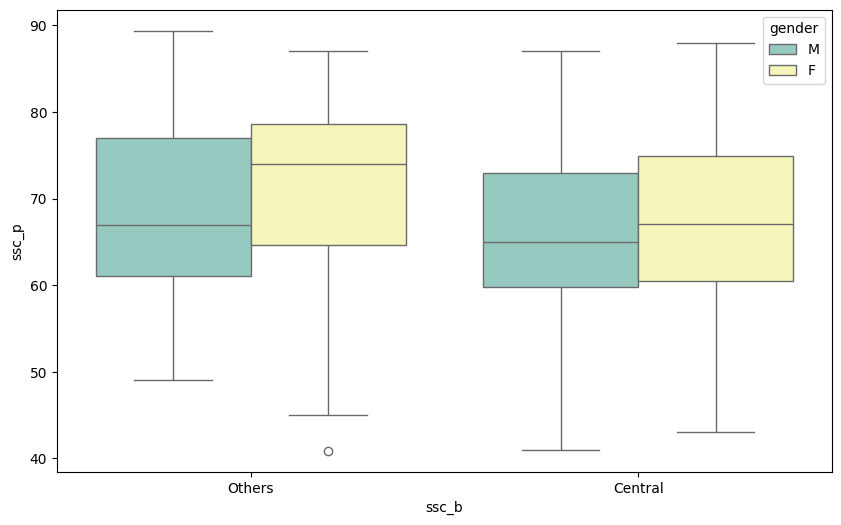

In [78]:
plt.figure(figsize=(10,6))
ax = sns.boxplot(x="ssc_b", y="ssc_p", hue="gender",
                 data=cp, palette="Set3")

7. Heat map

[None, None, None, None, None, None, None, None, None, None, None, None]

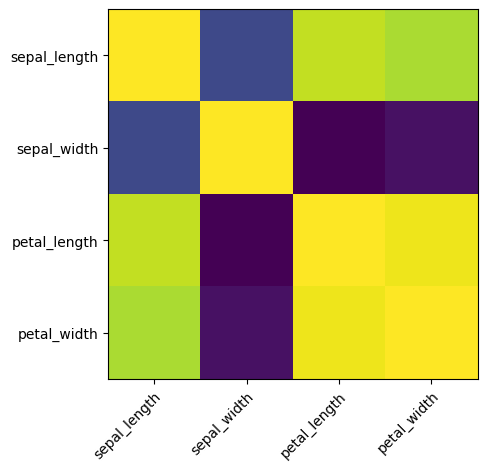

In [85]:
# get correlation matrix
corr = iris.drop(['species'], axis=1).corr()
fig, ax = plt.subplots()
# create heatmap
im = ax.imshow(corr.values)

# set labels
ax.set_xticks(np.arange(len(corr.columns)))
ax.set_yticks(np.arange(len(corr.columns)))
ax.set_xticklabels(corr.columns)
ax.set_yticklabels(corr.columns)

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

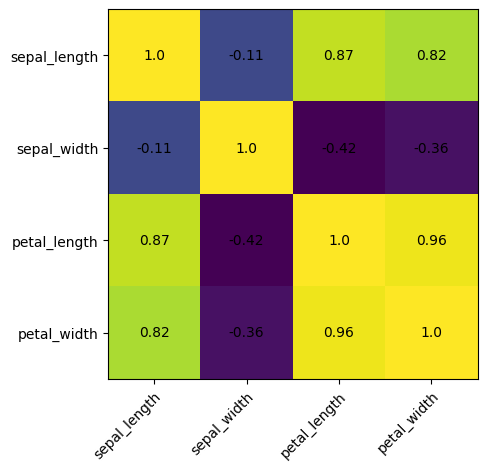

In [86]:
# get correlation matrix
corr = iris.drop(['species'], axis=1).corr()
fig, ax = plt.subplots()
# create heatmap
im = ax.imshow(corr.values)

# set labels
ax.set_xticks(np.arange(len(corr.columns)))
ax.set_yticks(np.arange(len(corr.columns)))
ax.set_xticklabels(corr.columns)
ax.set_yticklabels(corr.columns)

# Rotate the tick labels and set their alignment.
plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
         rotation_mode="anchor")

# Loop over data dimensions and create text annotations.
for i in range(len(corr.columns)):
    for j in range(len(corr.columns)):
        text = ax.text(j, i, np.around(corr.iloc[i, j], decimals=2),
                       ha="center", va="center", color="black")

<Axes: >

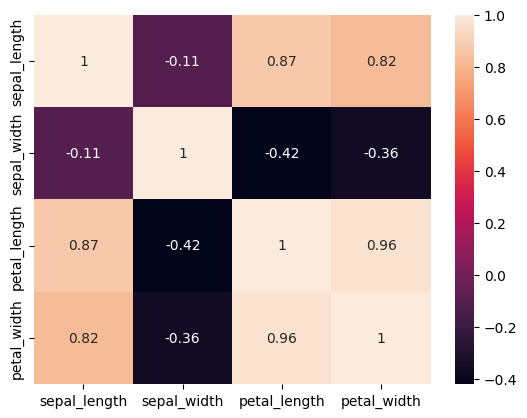

In [10]:
sns.heatmap(iris.drop(['species'], axis=1).corr(), annot=True)

<Axes: xlabel='sl_no'>

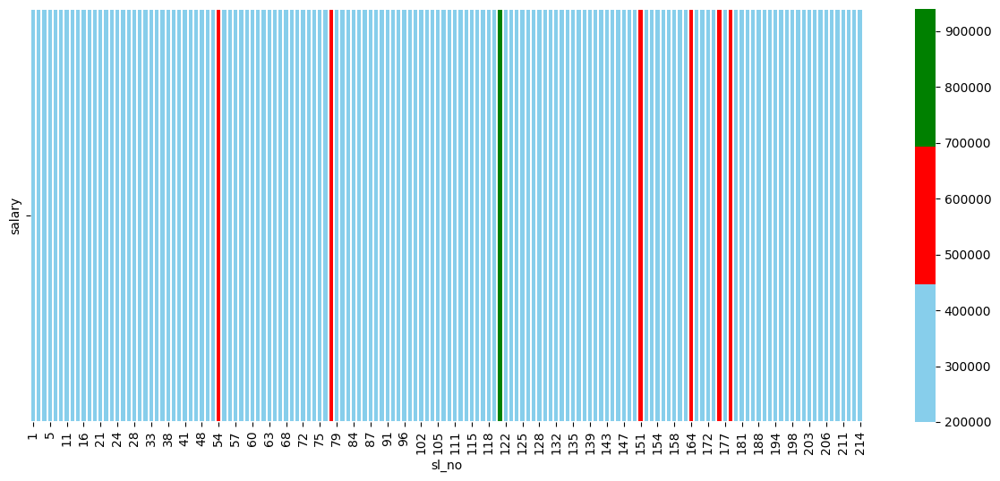

In [11]:
plt.figure(figsize=(15,6))
h=pd.pivot_table(cp,columns='sl_no',values=["salary"])
sns.heatmap(h,cmap=['skyblue','red','green'],linewidths=0.05)

8. Faceting

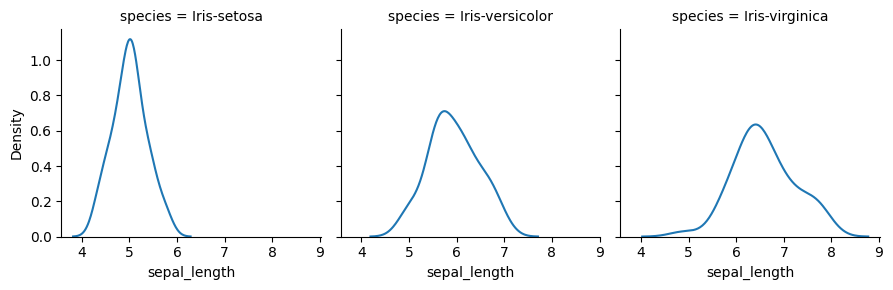

In [12]:
g = sns.FacetGrid(iris, col='species')
g = g.map(sns.kdeplot, 'sepal_length')

9. Pairplot

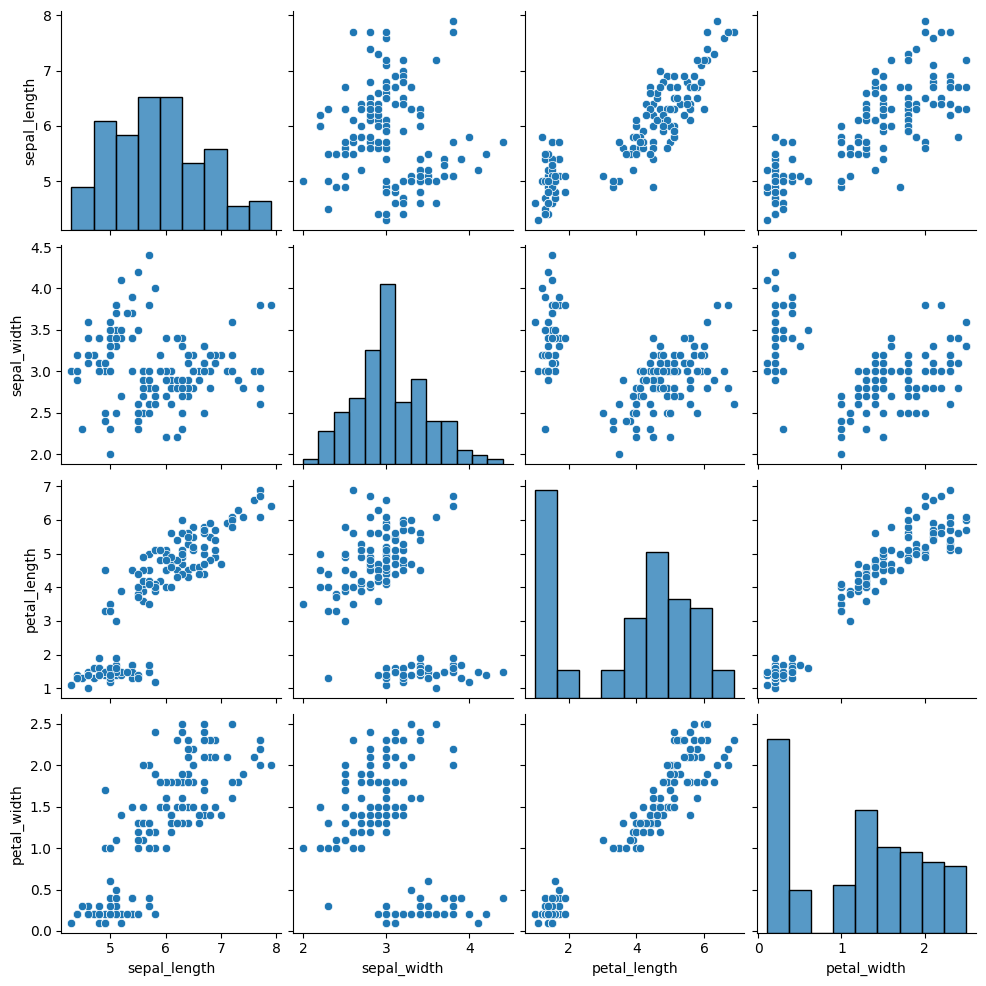

In [13]:
sns.pairplot(iris)

array([[<Axes: xlabel='sepal_length', ylabel='sepal_length'>,
        <Axes: xlabel='sepal_width', ylabel='sepal_length'>,
        <Axes: xlabel='petal_length', ylabel='sepal_length'>,
        <Axes: xlabel='petal_width', ylabel='sepal_length'>],
       [<Axes: xlabel='sepal_length', ylabel='sepal_width'>,
        <Axes: xlabel='sepal_width', ylabel='sepal_width'>,
        <Axes: xlabel='petal_length', ylabel='sepal_width'>,
        <Axes: xlabel='petal_width', ylabel='sepal_width'>],
       [<Axes: xlabel='sepal_length', ylabel='petal_length'>,
        <Axes: xlabel='sepal_width', ylabel='petal_length'>,
        <Axes: xlabel='petal_length', ylabel='petal_length'>,
        <Axes: xlabel='petal_width', ylabel='petal_length'>],
       [<Axes: xlabel='sepal_length', ylabel='petal_width'>,
        <Axes: xlabel='sepal_width', ylabel='petal_width'>,
        <Axes: xlabel='petal_length', ylabel='petal_width'>,
        <Axes: xlabel='petal_width', ylabel='petal_width'>]], dtype=object)

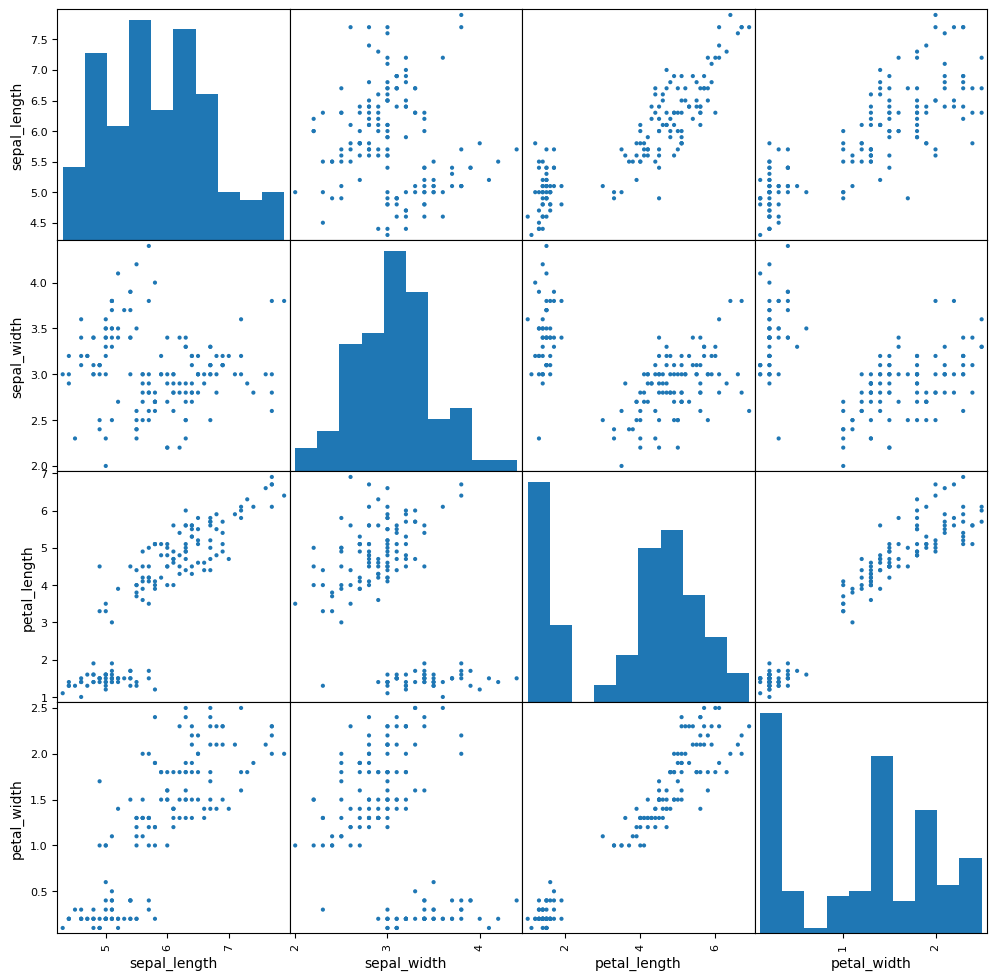

In [16]:
fig, ax = plt.subplots(figsize=(12,12))
scatter_matrix(iris, alpha=1, ax=ax)

In [48]:
choro_map=px.choropleth(corona_data, 
                    locations="Country/Region", 
                    locationmode = "country names",
                    color="Confirmed", 
                    hover_name="Country/Region", 
                    animation_frame="ObservationDate"
                   )

choro_map.update_layout(
    title_text = 'Global Spread of Coronavirus',
    title_x = 0.5,
    geo=dict(
        showframe = False,
        showcoastlines = False,
    ))

# choro_map.show()

10. Tree Plot

In [47]:
covid_India_cases.rename(columns={'State/UnionTerritory': 'State', 'Cured': 'Recovered', 'Confirmed': 'Confirmed'}, inplace=True)

statewise_cases = pd.DataFrame(covid_India_cases.groupby(['State'])[['Confirmed', 'Deaths', 'Recovered']].max().reset_index())
statewise_cases["Country"] = "India" # in order to have a single root node
fig = px.treemap(statewise_cases, path=['Country','State'], values='Confirmed',
                  color='Confirmed', hover_data=['State'],
                  color_continuous_scale='Rainbow')
# fig.show()

11. Sunburst plot

In [46]:
sales = sales.tail(20)
fig = px.sunburst(sales, path=["item_category_id",'item_id'],
                  color='item_category_id', hover_data=['item_id'],
                  color_continuous_scale='thermal')
# fig.show()

12. Bubble plot

In [34]:
# THIS DOES NOT WORK (Bubbly is likely not updated)
# figure = bubbleplot(dataset=m, x_column='beds', y_column='population', 
#     bubble_column='state', size_column='beds', color_column='type', 
#     x_logscale=True, scale_bubble=2, height=350)

# iplot(figure)

13. Calendar plot

<Axes: >

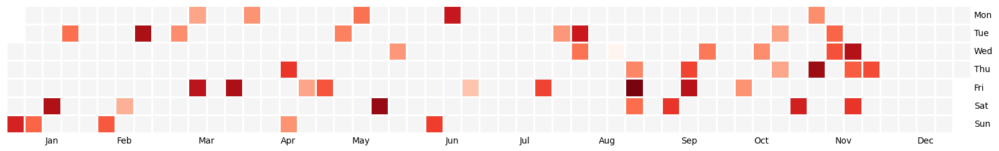

In [38]:
f = plt.figure(figsize=(20,10))
all_days = pd.date_range('1/1/2019', periods=700, freq='D')
days = np.random.choice(all_days, 100)
events = pd.Series(np.random.randn(len(days)), index=days)
calmap.yearplot(events, year=2020)

14. Violin plot

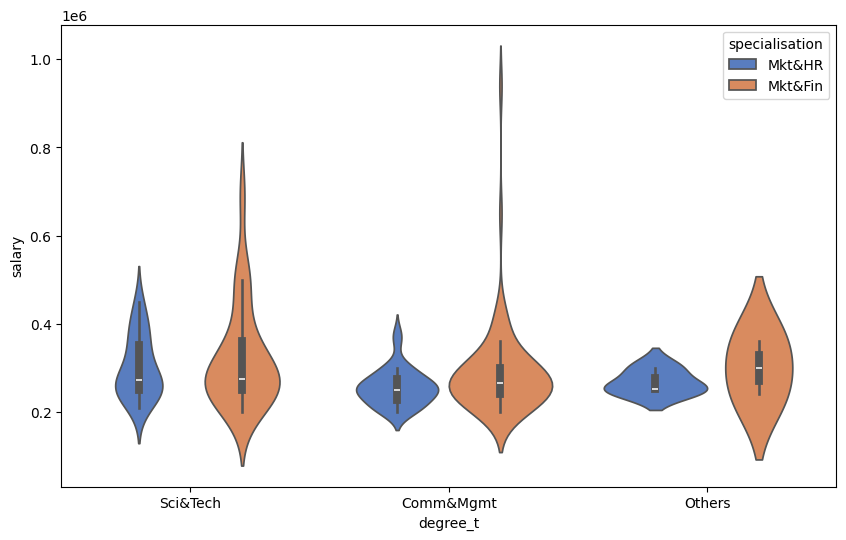

In [39]:
plt.figure(figsize=(10,6))
ax = sns.violinplot(x="degree_t", y="salary", hue="specialisation",
                    data=cp, palette="muted")

15. Folium plot

In [45]:
map = folium.Map(location=[37.0902,-95.7129 ], zoom_start=4,tiles='cartodbpositron')

for lat, lon,state,type in zip(m['lat'], m['lng'],m['state'],m['type']):
    folium.CircleMarker([lat, lon],
                        radius=5,
                        color='red',
                      popup =(
                    'State: ' + str(state) + '<br>'),

                        fill_color='red',
                        fill_opacity=0.7 ).add_to(map)
# map

16. Choropleth

In [44]:
fig = px.choropleth(m, locations=m["state"],       

 color=m["beds"],
                    locationmode="USA-states",
                    scope="usa",
                    color_continuous_scale='Reds',
                   )

# fig.show()

17. Rose plot

In [50]:
df = px.data.wind()
fig = px.bar_polar(df, r="frequency", theta="direction",
                   color="strength", template="plotly_dark",
                   color_discrete_sequence= px.colors.sequential.Plasma_r)
# fig.show()

In [54]:
fig = go.Figure()

fig.add_trace(go.Barpolar(
    r=[77.5, 72.5, 70.0, 45.0, 22.5, 42.5, 40.0, 62.5],
    name='11-14 m/s',
    marker_color='rgb(106,81,163)'
))
fig.add_trace(go.Barpolar(
    r=[57.5, 50.0, 45.0, 35.0, 20.0, 22.5, 37.5, 55.0],
    name='8-11 m/s',
    marker_color='rgb(158,154,200)'
))
fig.add_trace(go.Barpolar(
    r=[40.0, 30.0, 30.0, 35.0, 7.5, 7.5, 32.5, 40.0],
    name='5-8 m/s',
    marker_color='rgb(203,201,226)'
))
fig.add_trace(go.Barpolar(
    r=[20.0, 7.5, 15.0, 22.5, 2.5, 2.5, 12.5, 22.5],
    name='< 5 m/s',
    marker_color='rgb(242,240,247)'
))

fig.update_traces(text=['North', 'N-E', 'East', 'S-E', 'South', 'S-W', 'West', 'N-W'])
fig.update_layout(
    title='Wind Speed Distribution in Laurel, NE',
    font_size=16,
    legend_font_size=16,
    polar_radialaxis_ticksuffix='%',
    polar_angularaxis_rotation=90,

)
# fig.show()

In [60]:
# THIS DOES NOT WORK (Probably a lack of an API key)
# matrix = [
#     [0, 5, 6, 4, 7, 4],
#     [5, 0, 5, 4, 6, 5],
#     [6, 5, 0, 4, 5, 5],
#     [4, 4, 4, 0, 5, 5],
#     [7, 6, 5, 5, 0, 4],
#     [4, 5, 5, 5, 4, 0],
# ]

# names = ["Action", "Adventure", "Comedy", "Drama", "Fantasy", "Thriller"]

# ax=Chord(matrix, names)
# ax.show()

# #get this graph from output file
# Chord(matrix, names, wrap_labels=False, label_color="#4c40bf").to_html()

## 3D-Plots

1. Surface plot

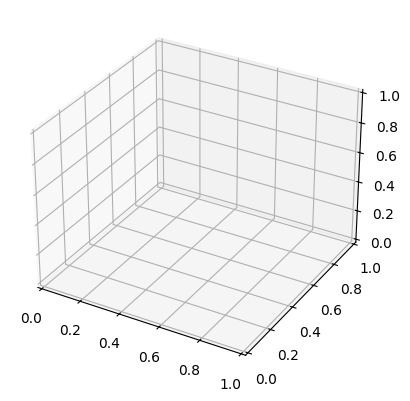

In [63]:
fig = plt.figure()
ax = plt.axes(projection="3d")

plt.show()

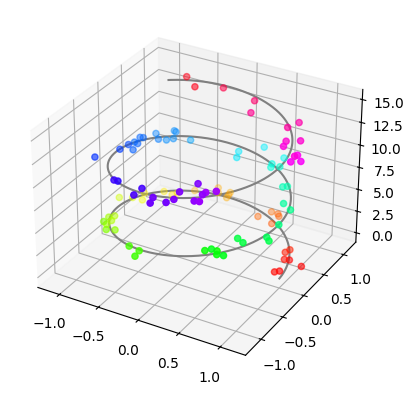

In [64]:
fig = plt.figure()
ax = plt.axes(projection="3d")

z_line = np.linspace(0, 15, 1000)
x_line = np.cos(z_line)
y_line = np.sin(z_line)
ax.plot3D(x_line, y_line, z_line, 'gray')

z_points = 15 * np.random.random(100)
x_points = np.cos(z_points) + 0.1 * np.random.randn(100)
y_points = np.sin(z_points) + 0.1 * np.random.randn(100)
ax.scatter3D(x_points, y_points, z_points, c=z_points, cmap='hsv')

plt.show()

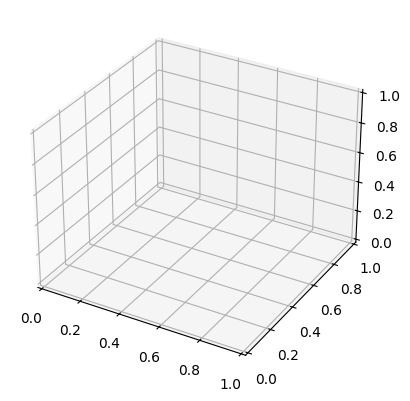

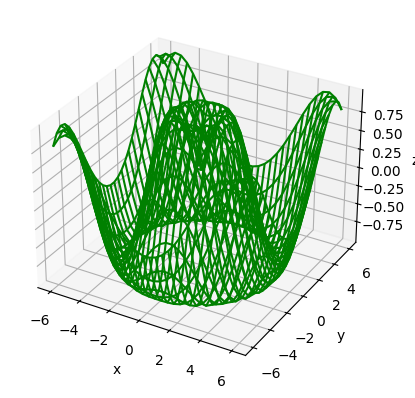

In [65]:
fig = plt.figure()
ax = plt.axes(projection="3d")
def z_function(x, y):
    return np.sin(np.sqrt(x ** 2 + y ** 2))

x = np.linspace(-6, 6, 30)
y = np.linspace(-6, 6, 30)

X, Y = np.meshgrid(x, y)
Z = z_function(X, Y)

fig = plt.figure()
ax = plt.axes(projection="3d")
ax.plot_wireframe(X, Y, Z, color='green')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

plt.show()

Text(0.5, 0.92, 'surface')

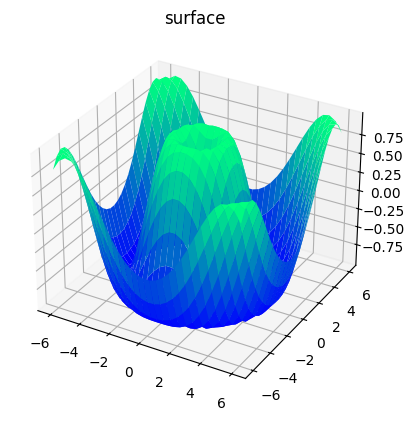

In [69]:
ax = plt.axes(projection='3d')
ax.plot_surface(X, Y, Z, rstride=1, cstride=1,
                cmap='winter', edgecolor='none')
ax.set_title('surface')

In [75]:
#THIS DOES NOT WORK (Lack of csv file, see guide for example of output)

# # Get the data (csv file is hosted on the web)
# url = 'https://python-graph-gallery.com/wp-content/uploads/volcano.csv'
# data = pd.read_csv(url)

# # Transform it to a long format
# df=data.unstack().reset_index()
# df.columns=["X","Y","Z"]
 
# # And transform the old column name in something numeric
# df['X']=pd.Categorical(df['X'])
# df['X']=df['X'].cat.codes
 
# # Make the plot
# fig = plt.figure()
# ax = fig.gca(projection='3d')
# ax.plot_trisurf(df['Y'], df['X'], df['Z'], cmap=plt.cm.viridis, linewidth=0.2)
# plt.show()
 
# # to Add a color bar which maps values to colors.
# surf=ax.plot_trisurf(df['Y'], df['X'], df['Z'], cmap=plt.cm.viridis, linewidth=0.2)
# fig.colorbar( surf, shrink=0.5, aspect=5)
# plt.show()

# # Rotate it
# ax.view_init(30, 45)
# plt.show()
 
# # Other palette
# ax.plot_trisurf(df['Y'], df['X'], df['Z'], cmap=plt.cm.jet, linewidth=0.01)
# plt.show()

2. Scatter plot

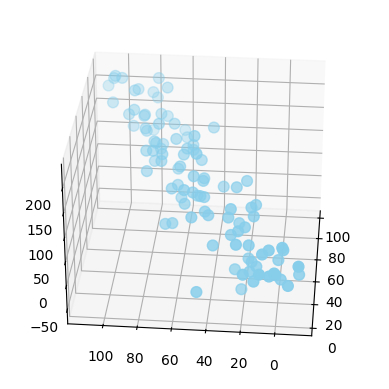

In [77]:
# Dataset
df=pd.DataFrame({'X': range(1,101), 'Y': np.random.randn(100)*15+range(1,101), 'Z': (np.random.randn(100)*15+range(1,101))*2 })
 
# plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(df['X'], df['Y'], df['Z'], c='skyblue', s=60)
ax.view_init(30, 185)
plt.show()

<Figure size 480x480 with 0 Axes>

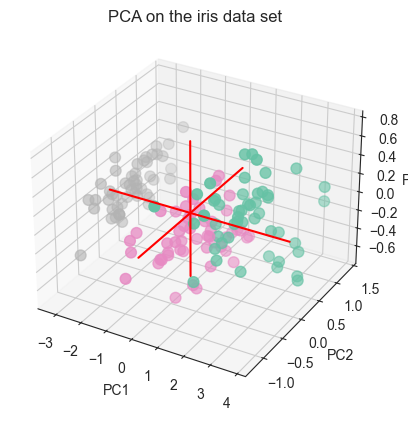

In [82]:
# PCA
sns.set_style("white")
my_dpi=96
plt.figure(figsize=(480/my_dpi, 480/my_dpi), dpi=my_dpi)
 
# Keep the 'specie' column appart + make it numeric for coloring
iris['species']=pd.Categorical(iris['species'])
my_color=iris['species'].cat.codes
iris = iris.drop('species', axis=1)
 
# Run The PCA
pca = PCA(n_components=3)
pca.fit(iris)

# Store results of PCA in a data frame
result=pd.DataFrame(pca.transform(iris), columns=['PCA%i' % i for i in range(3)], index=iris.index)
 
# Plot initialisation
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(result['PCA0'], result['PCA1'], result['PCA2'], c=my_color, cmap="Set2_r", s=60)

# make simple, bare axis lines through space:
xAxisLine = ((min(result['PCA0']), max(result['PCA0'])), (0, 0), (0,0))
ax.plot(xAxisLine[0], xAxisLine[1], xAxisLine[2], 'r')
yAxisLine = ((0, 0), (min(result['PCA1']), max(result['PCA1'])), (0,0))
ax.plot(yAxisLine[0], yAxisLine[1], yAxisLine[2], 'r')
zAxisLine = ((0, 0), (0,0), (min(result['PCA2']), max(result['PCA2'])))
ax.plot(zAxisLine[0], zAxisLine[1], zAxisLine[2], 'r')

# label the axes
ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
ax.set_zlabel("PC3")
ax.set_title("PCA on the iris data set")
plt.show()

3. Bar plot

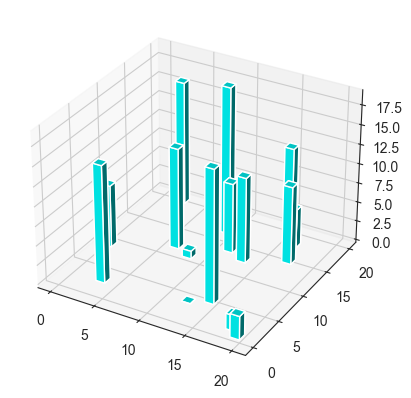

In [85]:
fig = plt.figure()
ax = plt.axes(projection="3d")

num_bars = 15
x_pos = random.sample(range(20), num_bars)
y_pos = random.sample(range(20), num_bars)
z_pos = [0] * num_bars
x_size = np.ones(num_bars)
y_size = np.ones(num_bars)
z_size = random.sample(range(20), num_bars)

ax.bar3d(x_pos, y_pos, z_pos, x_size, y_size, z_size, color='aqua')
plt.show()

4. Volume plot

In [86]:
X, Y, Z = np.mgrid[-8:8:40j, -8:8:40j, -8:8:40j]
values = np.sin(X*Y*Z) / (X*Y*Z)

fig = go.Figure(data=go.Volume(
    x=X.flatten(),
    y=Y.flatten(),
    z=Z.flatten(),
    value=values.flatten(),
    isomin=0.1,
    isomax=0.8,
    opacity=0.1, # needs to be small to see through all surfaces
    surface_count=17, # needs to be a large number for good volume rendering
    ))
fig.show()